In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load cleaned datasets
file_paths = {
    "sports_management_agencies": r"C:\Users\nadza\Downloads\sports_management_agencies.csv",
    "sponsors_dataset": r"C:\Users\nadza\Downloads\sponsors_dataset_.csv",
    "communication_boxes": r"C:\Users\nadza\Downloads\communication_boxes_africa_updated.csv",
}

datasets = {name: pd.read_csv(path) for name, path in file_paths.items()}

In [6]:
# Display dataset summaries
def dataset_summary(df, name):
    print(f"Dataset: {name}\n")
    print(f"Rows: {df.shape[0]}, Columns: {df.shape[1]}")
    print("\nMissing Values:\n", df.isnull().sum())
    print("\nDuplicate Rows:", df.duplicated().sum())
    print("\nData Types:\n", df.dtypes)
    print("\n" + "="*50 + "\n")

for name, df in datasets.items():
    dataset_summary(df, name)

Dataset: sports_management_agencies

Rows: 586, Columns: 7

Missing Values:
 agency_id           0
agency_name         0
services_offered    0
top_clients         0
region              0
contact_email       0
phone_number        0
dtype: int64

Duplicate Rows: 34

Data Types:
 agency_id            int64
agency_name         object
services_offered    object
top_clients         object
region              object
contact_email       object
phone_number        object
dtype: object


Dataset: sponsors_dataset

Rows: 228, Columns: 11

Missing Values:
 sponsor_id              0
company_name            0
industry                0
sponsorship_deals       0
contract_value          0
contract_duration       0
advertising_channels    0
location                0
contact_email           0
phone_number            0
website                 0
dtype: int64

Duplicate Rows: 0

Data Types:
 sponsor_id                int64
company_name             object
industry                 object
sponsorship_deals    

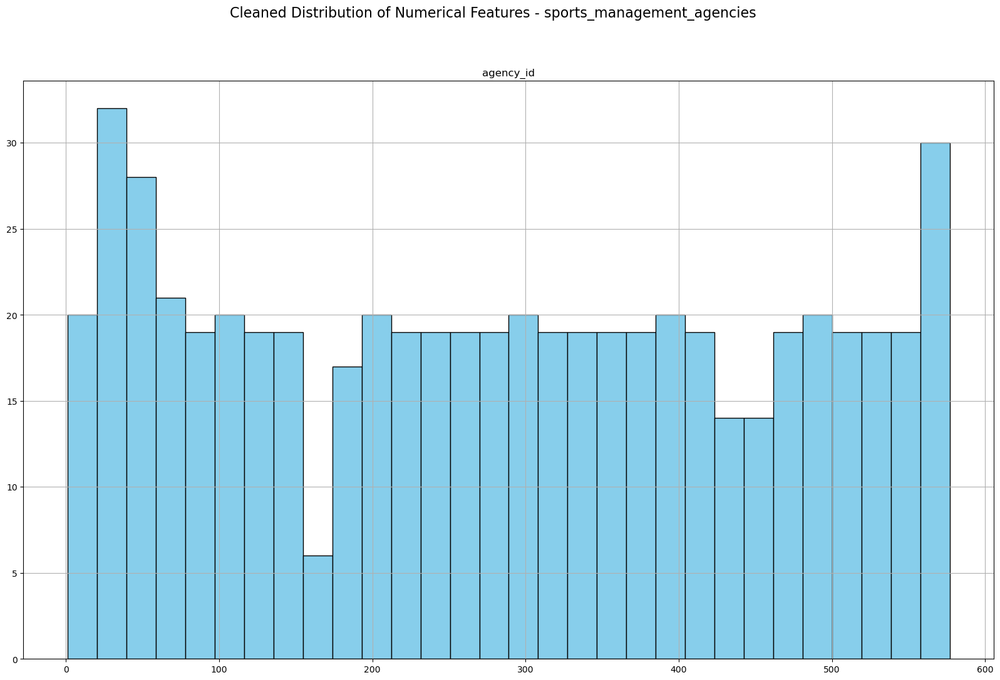

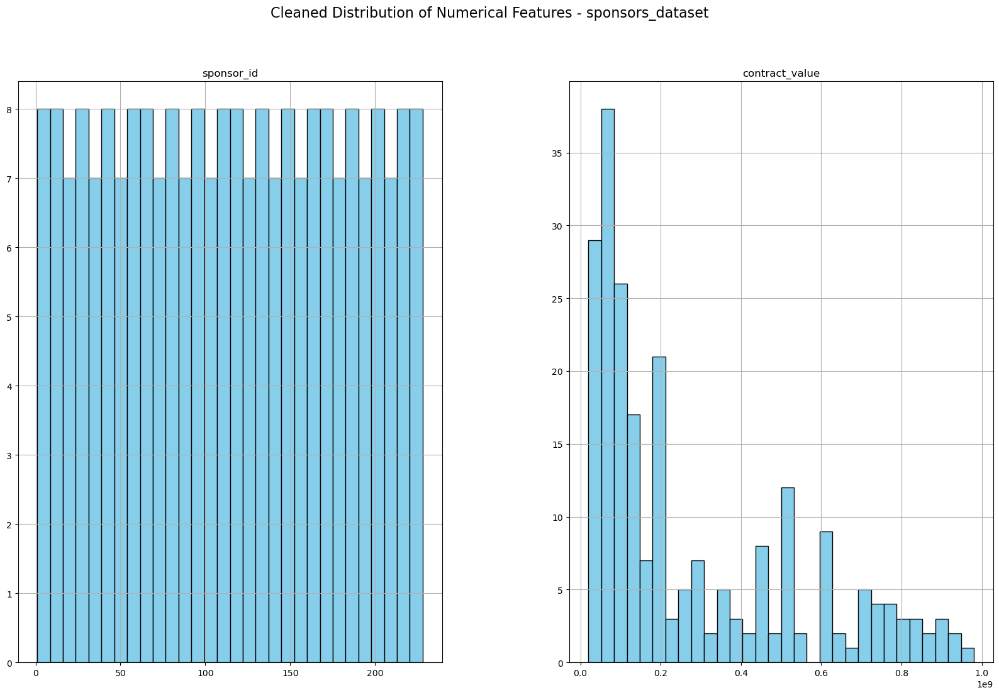

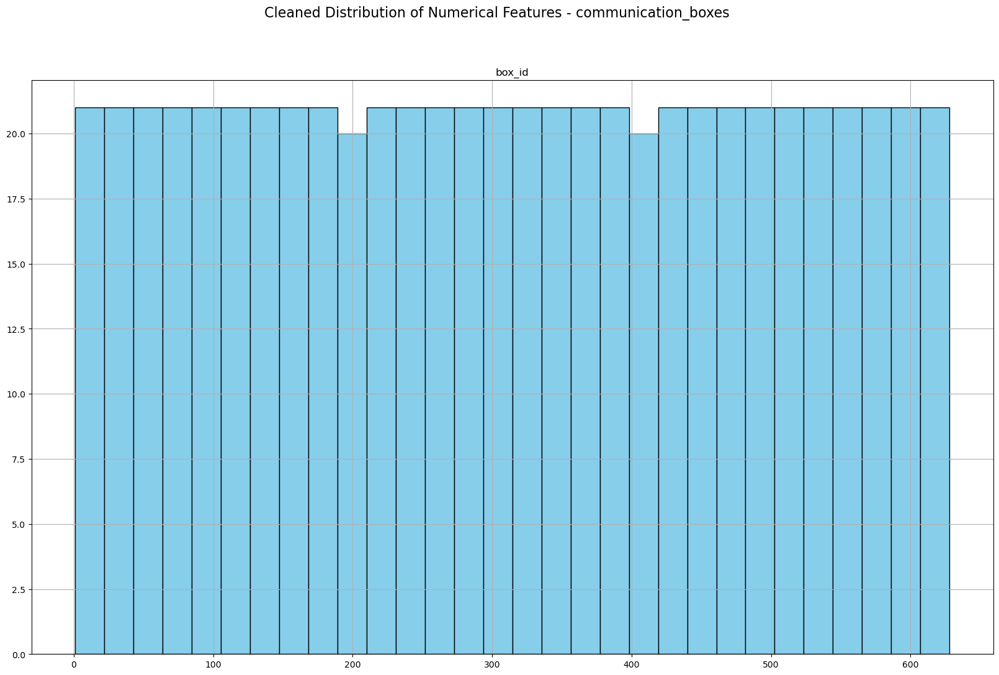

In [7]:
# Visualizing numerical feature distributions
def plot_numerical_distributions(df, name):
    num_cols = df.select_dtypes(include=['int64', 'float64']).columns
    if len(num_cols) > 0:
        df[num_cols].hist(bins=30, figsize=(20, 12), color='skyblue', edgecolor='black')
        plt.suptitle(f"Cleaned Distribution of Numerical Features - {name}", fontsize=16)
        plt.show()

for name, df in datasets.items():
    plot_numerical_distributions(df, name)

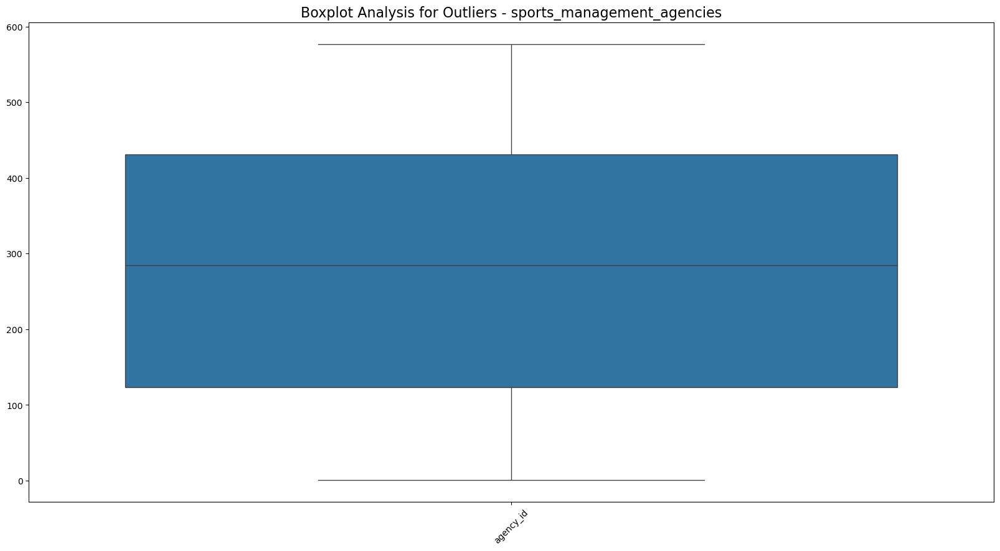

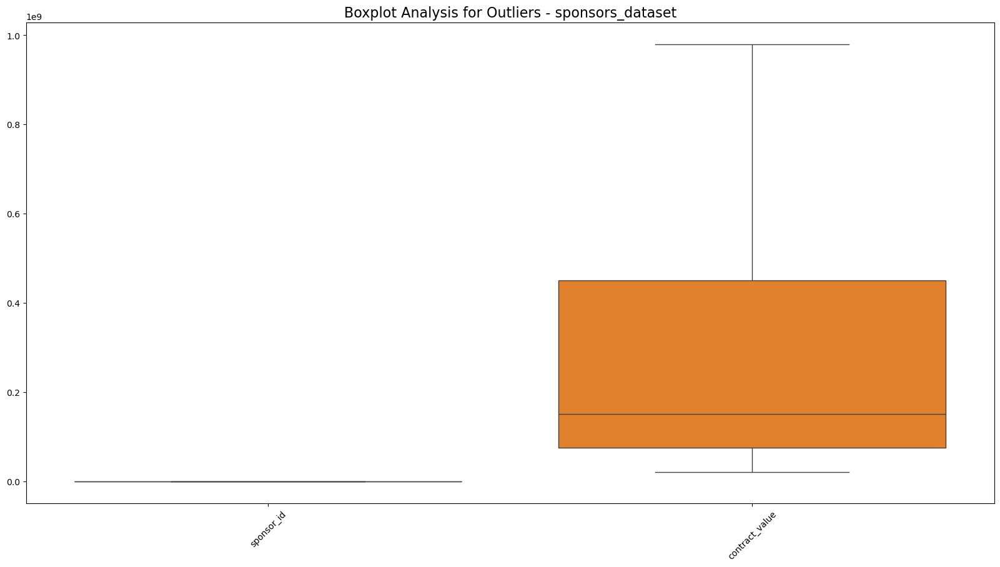

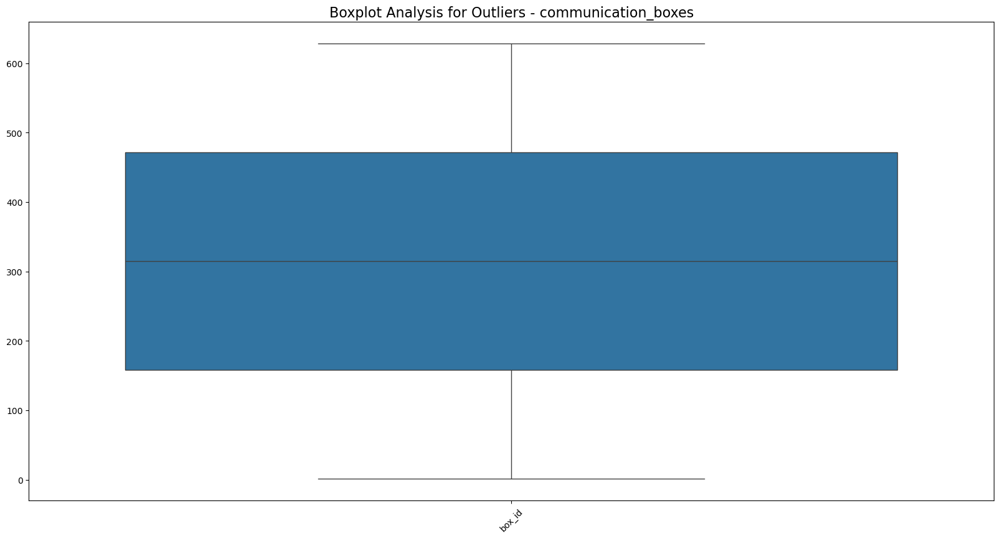

In [8]:
# Boxplots for detecting outliers
def plot_boxplots(df, name):
    num_cols = df.select_dtypes(include=['int64', 'float64']).columns
    if len(num_cols) > 0:
        plt.figure(figsize=(20, 10))
        sns.boxplot(data=df[num_cols])
        plt.title(f"Boxplot Analysis for Outliers - {name}", fontsize=16)
        plt.xticks(rotation=45)
        plt.show()

for name, df in datasets.items():
    plot_boxplots(df, name)

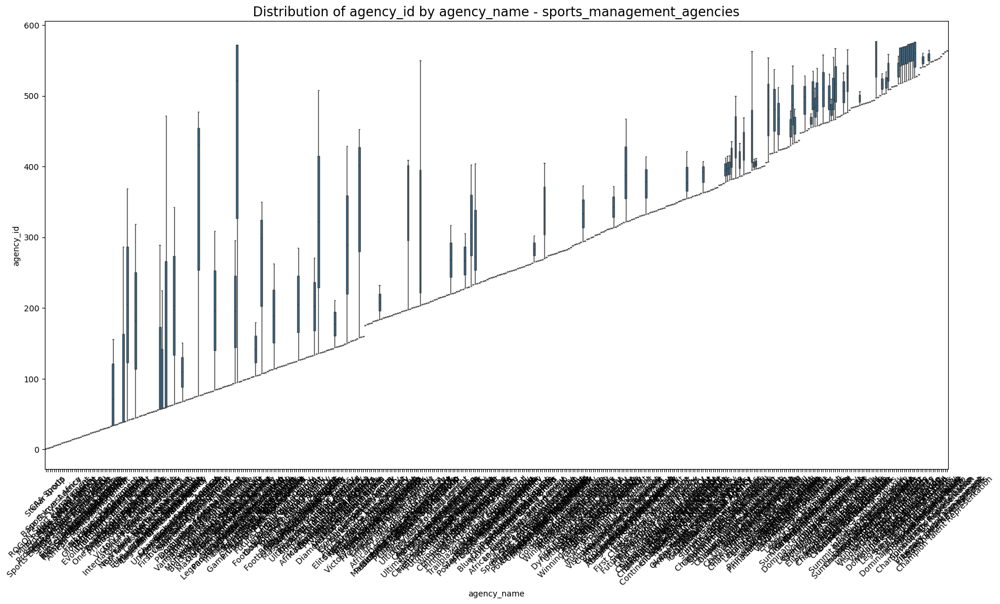

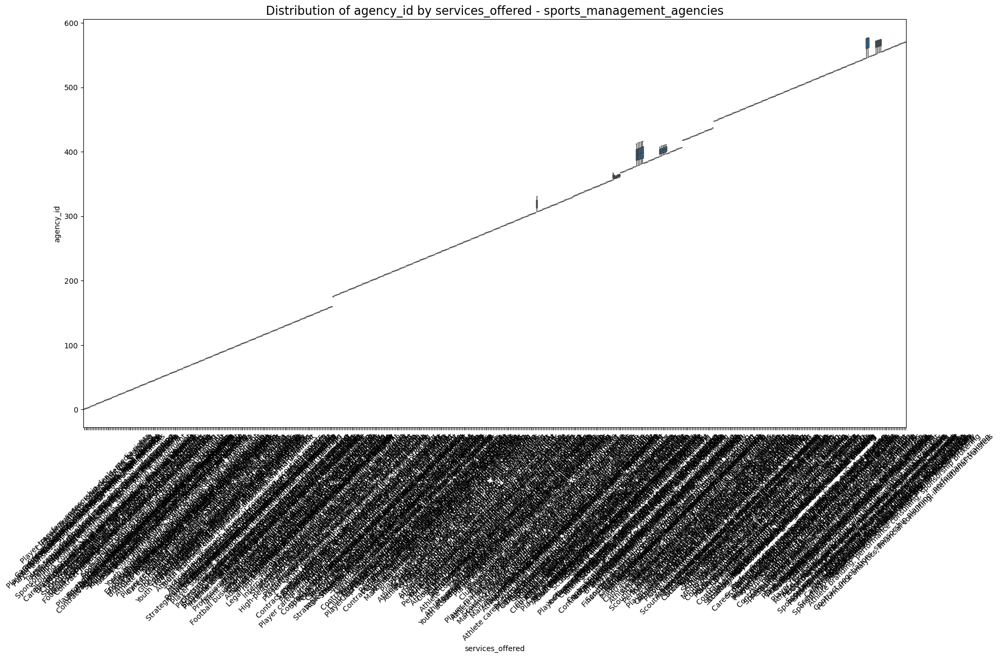

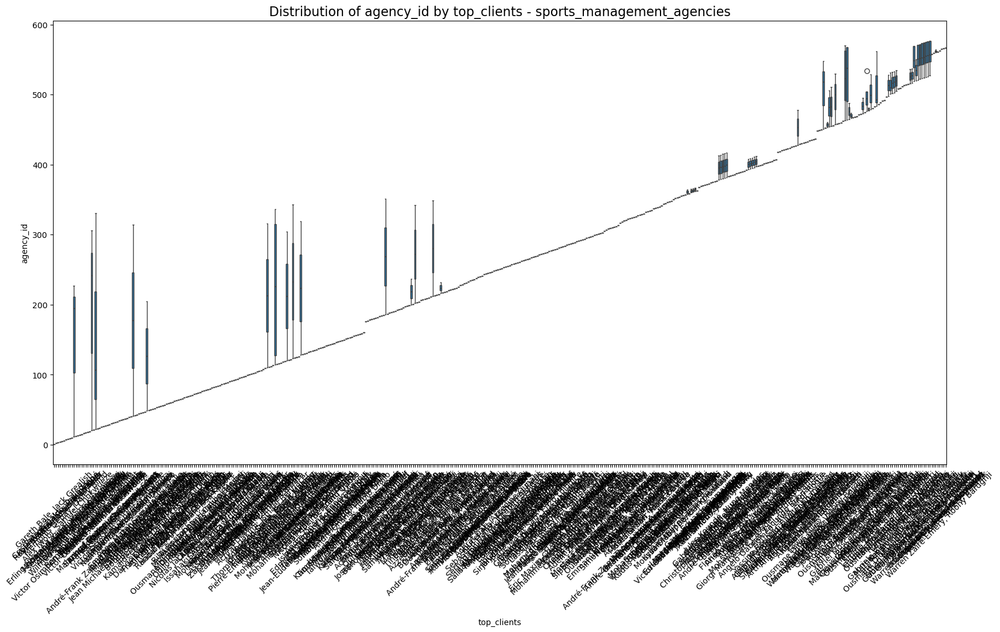

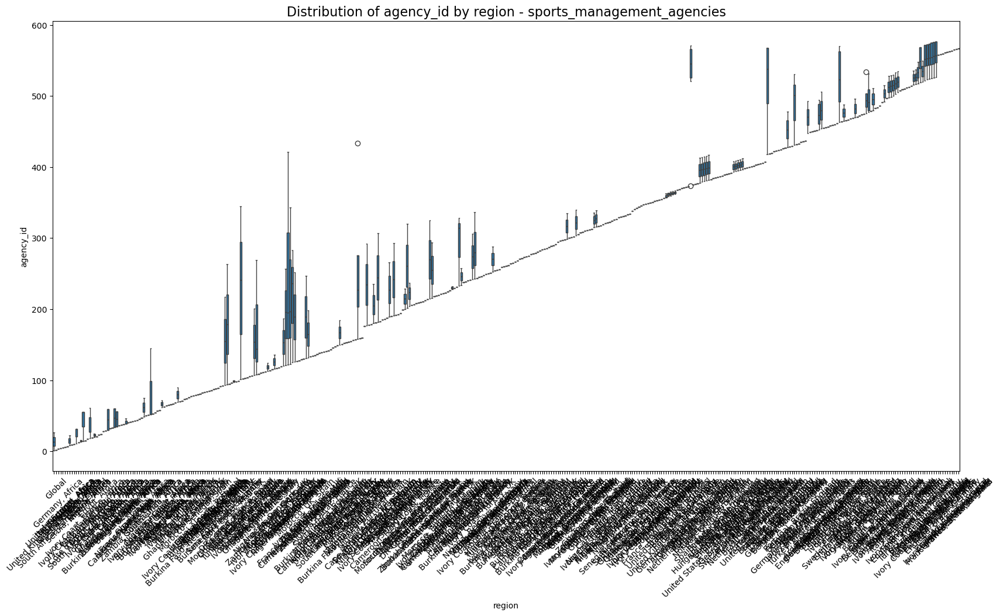

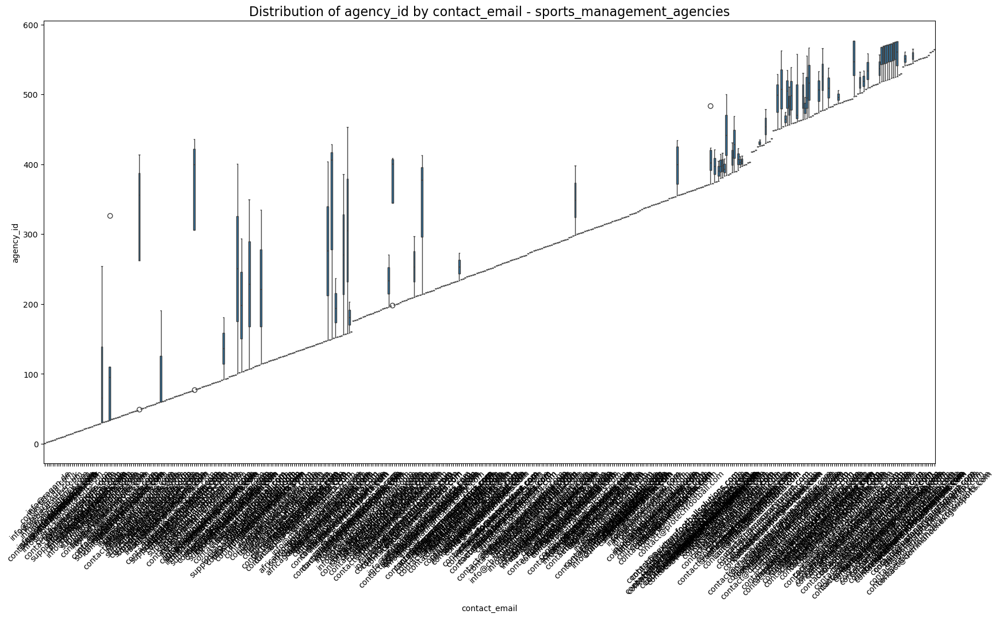

...

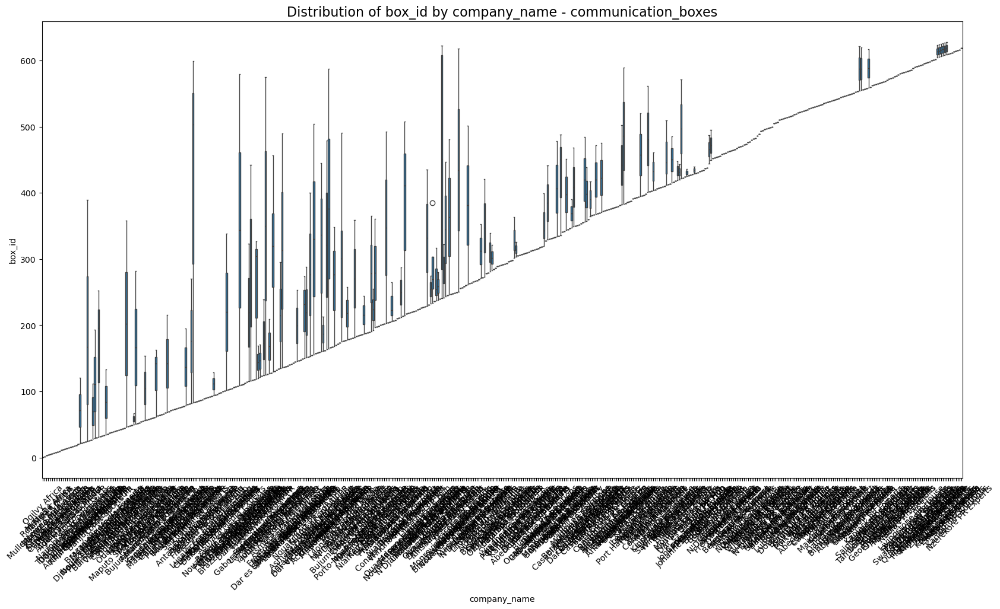

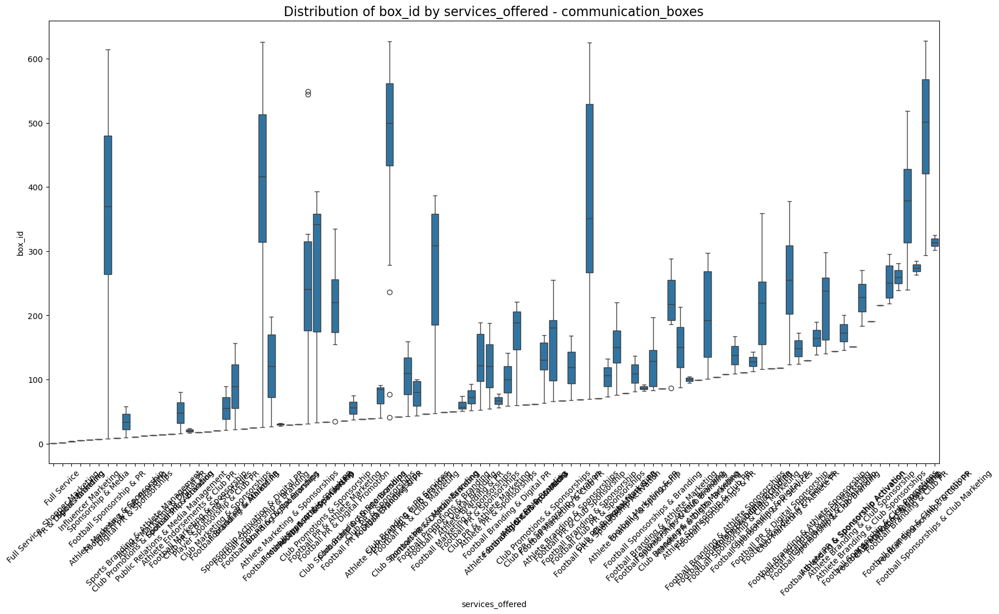

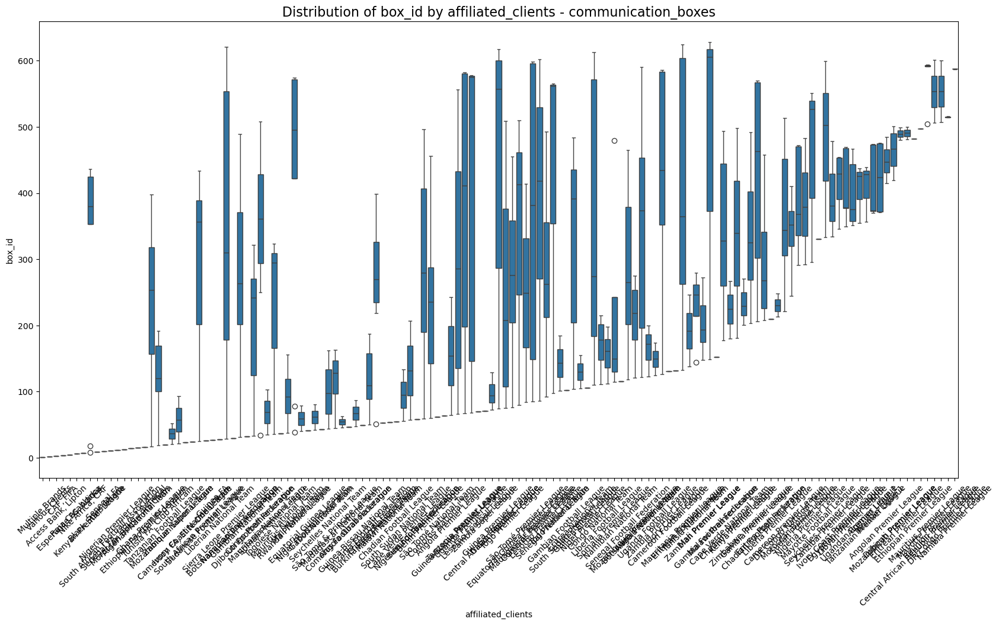

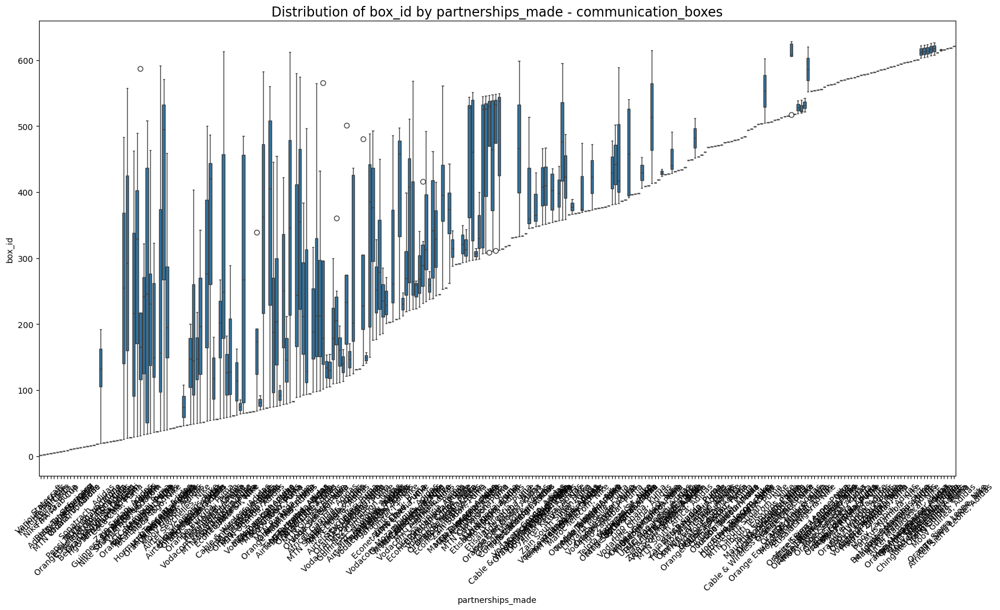

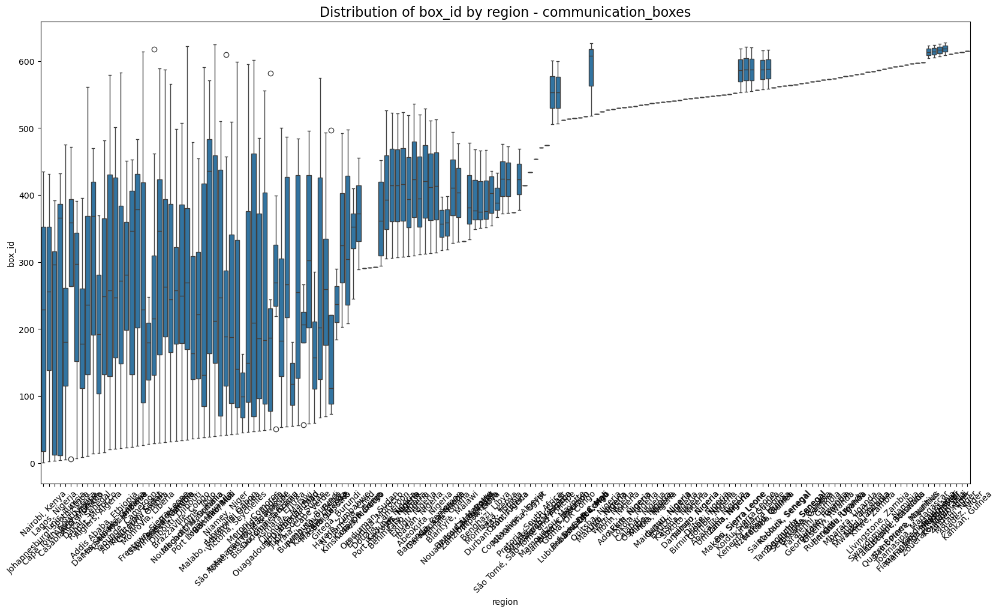

In [9]:
# Visualizing relationships between categorical and numerical variables
def plot_categorical_relationships(df, name):
    cat_cols = df.select_dtypes(include=['object']).columns
    num_cols = df.select_dtypes(include=['int64', 'float64']).columns
    
    if len(cat_cols) > 0 and len(num_cols) > 0:
        for cat_col in cat_cols[:5]:  # Display more categorical columns
            for num_col in num_cols[:5]:  # Display more numerical columns
                plt.figure(figsize=(20, 10))
                sns.boxplot(x=df[cat_col], y=df[num_col])
                plt.xticks(rotation=45)
                plt.title(f"Distribution of {num_col} by {cat_col} - {name}", fontsize=16)
                plt.show()

for name, df in datasets.items():
    plot_categorical_relationships(df, name)

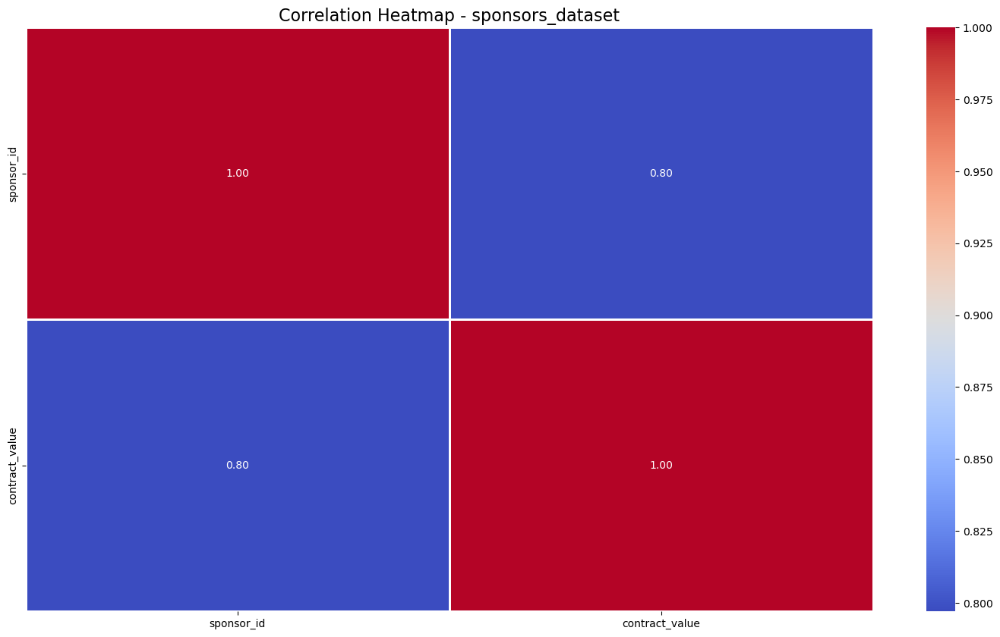

In [10]:
# Correlation Heatmaps
def plot_correlation_heatmap(df, name):
    num_cols = df.select_dtypes(include=['int64', 'float64']).columns
    if len(num_cols) > 1:
        plt.figure(figsize=(18, 10))
        sns.heatmap(df[num_cols].corr(), annot=True, cmap='coolwarm', fmt='.2f', linewidths=1)
        plt.title(f"Correlation Heatmap - {name}", fontsize=16)
        plt.show()

for name, df in datasets.items():
    plot_correlation_heatmap(df, name)

<Figure size 2000x1200 with 0 Axes>

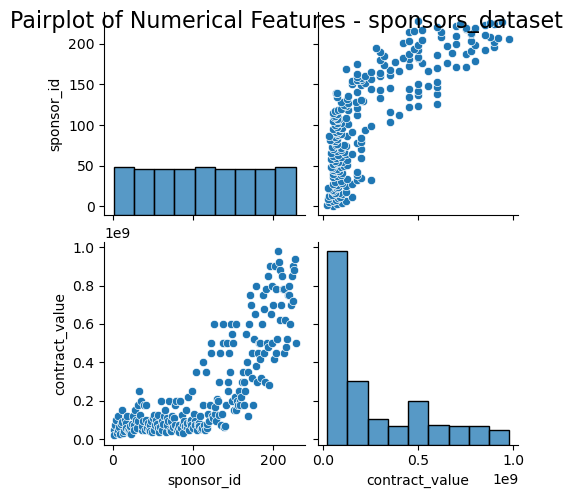

In [11]:
# Pairplot for numerical relationships
def plot_pairplot(df, name):
    num_cols = df.select_dtypes(include=['int64', 'float64']).columns
    if len(num_cols) > 1:
        plt.figure(figsize=(20, 12))
        sns.pairplot(df[num_cols])
        plt.suptitle(f"Pairplot of Numerical Features - {name}", fontsize=16)
        plt.show()

for name, df in datasets.items():
    plot_pairplot(df, name)

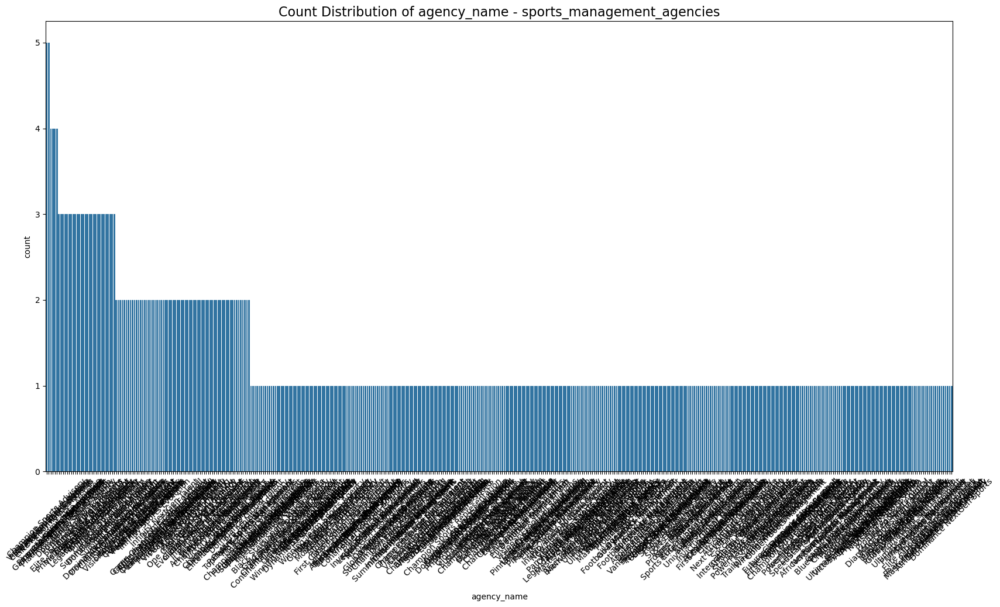

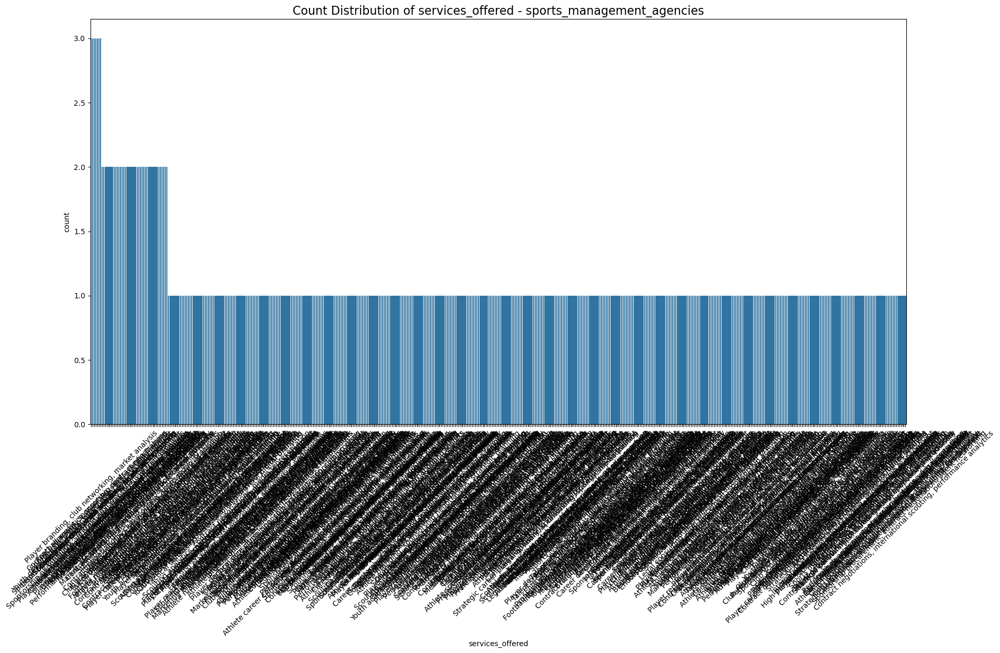

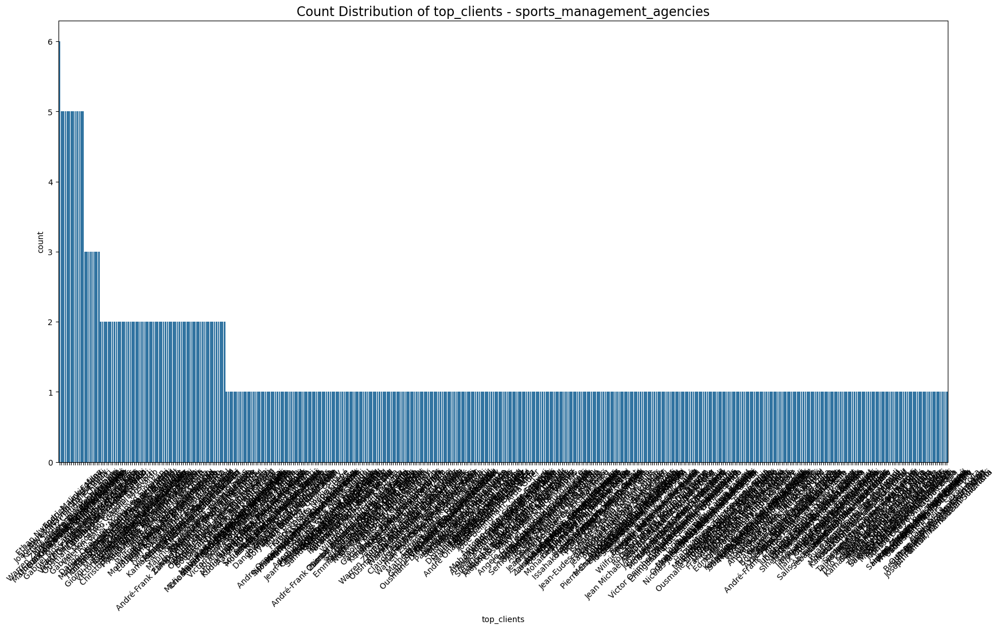

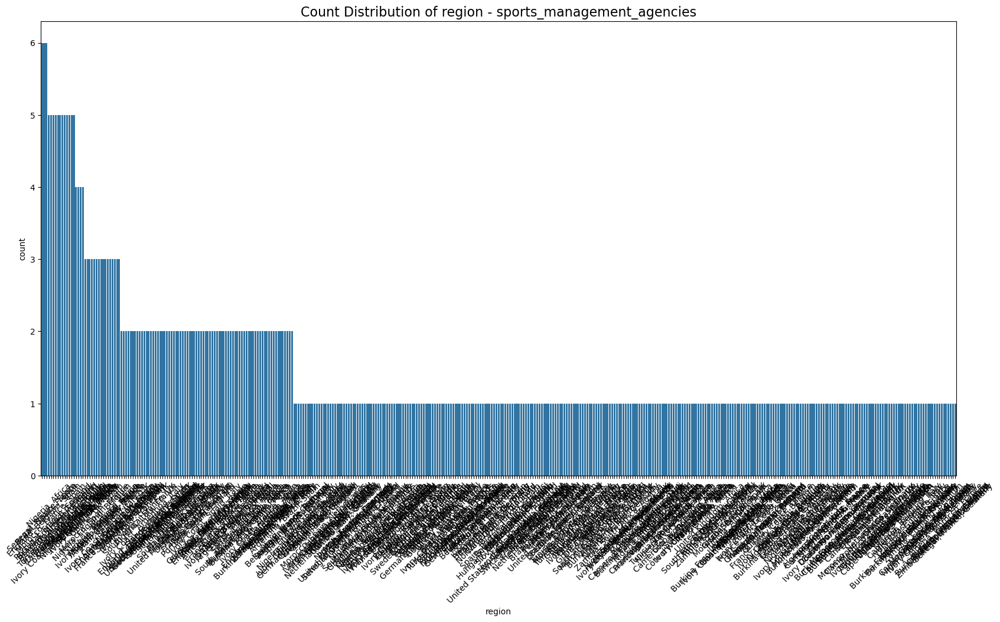

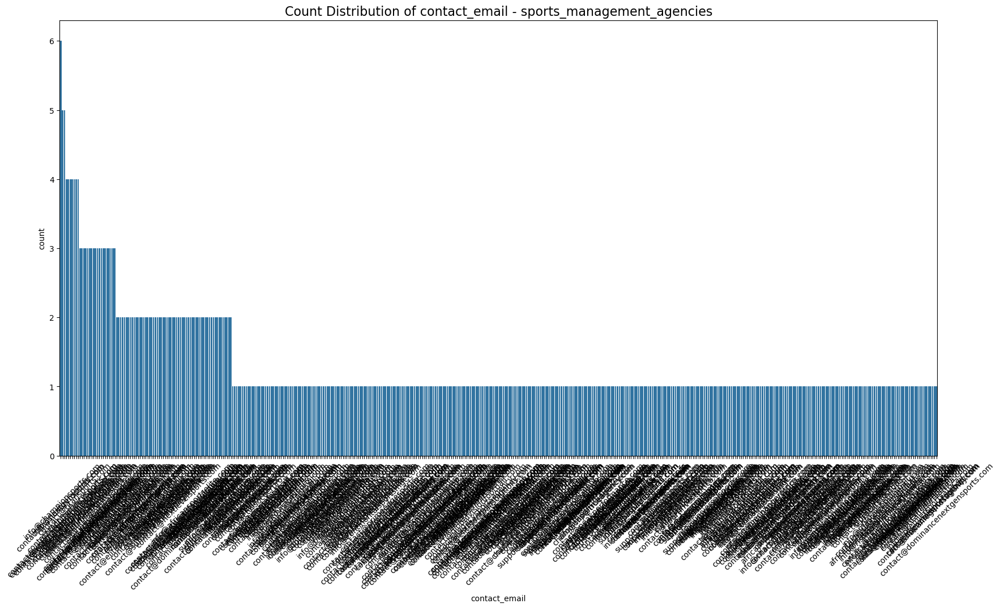

...

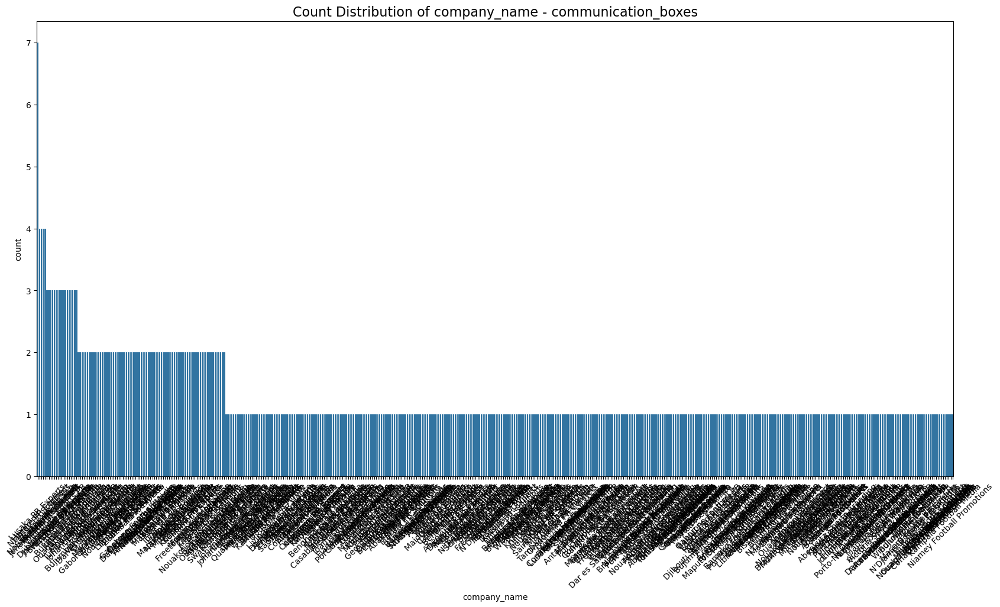

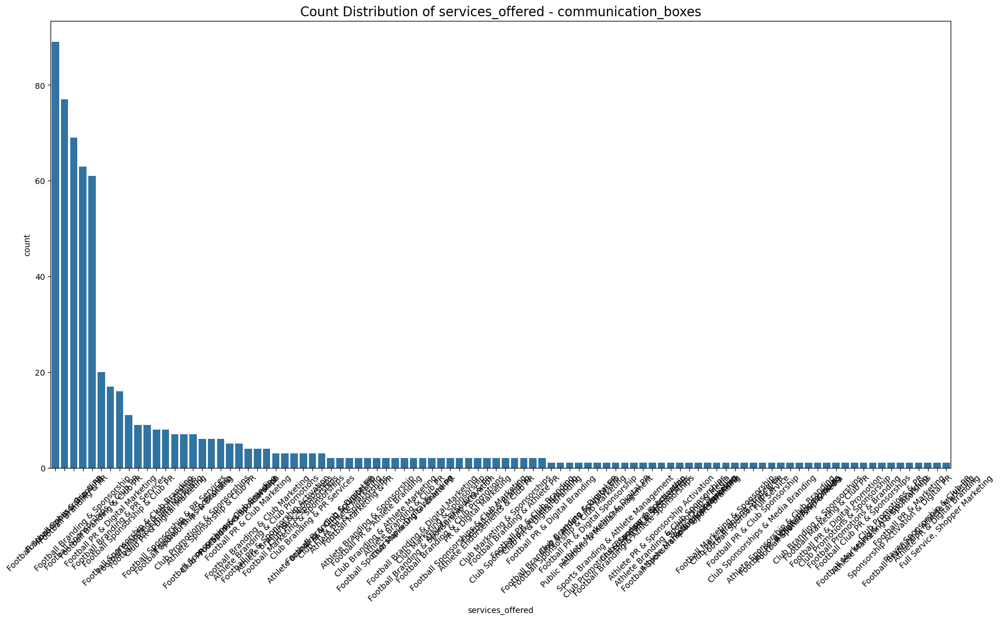

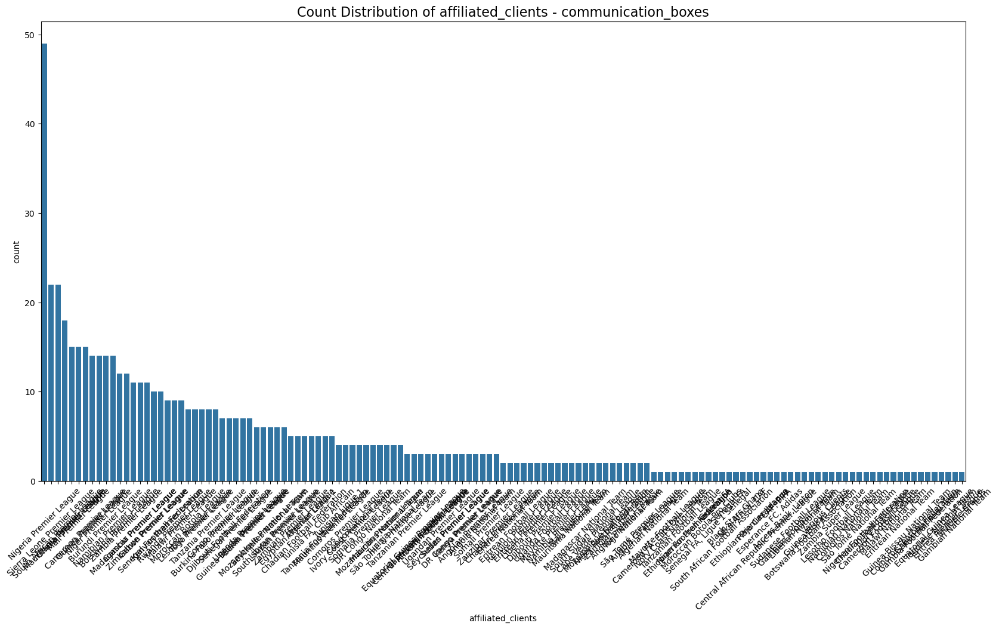

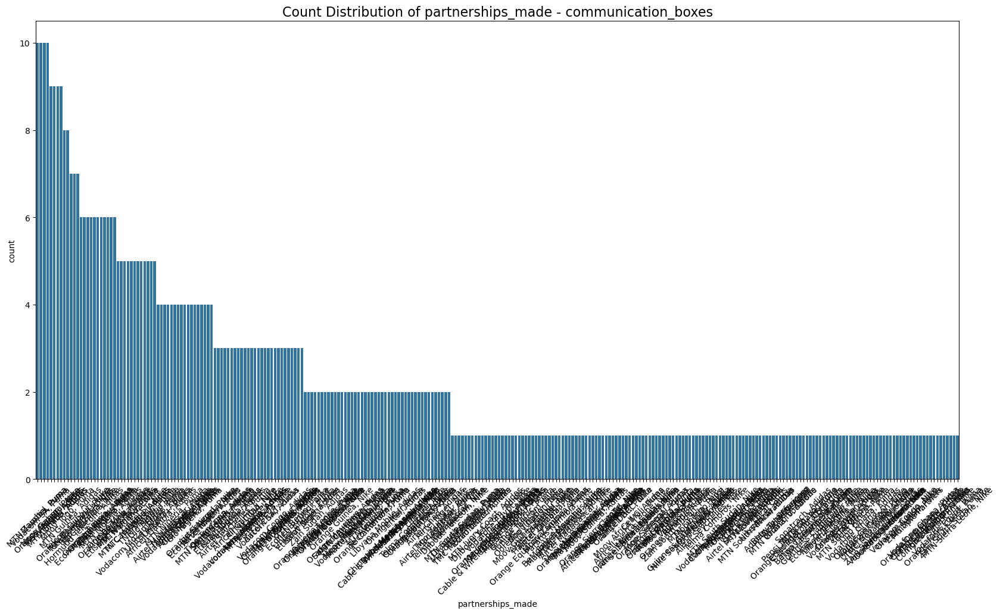

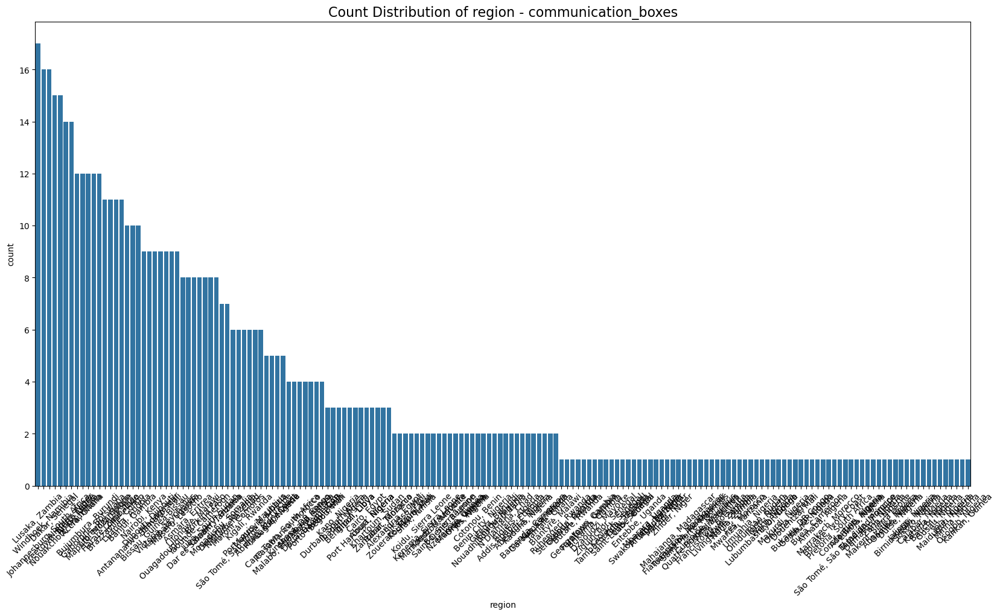

In [12]:
# Countplots for categorical features
def plot_categorical_counts(df, name):
    cat_cols = df.select_dtypes(include=['object']).columns
    
    for cat_col in cat_cols[:5]:  # Limit to 5 categorical features
        plt.figure(figsize=(20, 10))
        sns.countplot(x=df[cat_col], order=df[cat_col].value_counts().index)
        plt.xticks(rotation=45)
        plt.title(f"Count Distribution of {cat_col} - {name}", fontsize=16)
        plt.show()

for name, df in datasets.items():
    plot_categorical_counts(df, name)

In [13]:


# Save final cleaned datasets
def save_cleaned_data(df, name):
    df.to_csv(f"{name}_final.csv", index=False)
    print(f"Saved: {name}_final.csv")

for name, df in datasets.items():
    save_cleaned_data(df, name)


Saved: sports_management_agencies_final.csv
Saved: sponsors_dataset_final.csv
Saved: communication_boxes_final.csv
